In [1]:
import pandas as pd
import geopandas as gpd
import numpy as np
from pysal.lib import weights
from splot.libpysal import plot_spatial_weights
from esda.moran import Moran, Moran_Local
from splot.esda import moran_scatterplot, plot_local_autocorrelation, lisa_cluster
import matplotlib.pyplot as plt
import folium
import matplotlib.colors as colors

import warnings
warnings.filterwarnings("ignore")

/home/erivelton/anaconda3/envs/CensoES/lib/python3.9/site-packages/geopandas/_compat.py:123: UserWarning: The Shapely GEOS version (3.11.1-CAPI-1.17.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(
/tmp/ipykernel_15232/3420603334.py:2: UserWarning: Shapely 2.0 is installed, but because PyGEOS is also installed, GeoPandas will still use PyGEOS by default for now. To force to use and test Shapely 2.0, you have to set the environment variable USE_PYGEOS=0. You can do this before starting the Python process, or in your code before importing geopandas:

import os
os.environ['USE_PYGEOS'] = '0'
import geopandas

In a future release, GeoPandas will switch to using Shapely by default. If you are using PyGEOS directly (calling PyGEOS functions on geometries from GeoPandas), this will then stop working and you are encouraged to migrate from PyGEOS to Shapely 2.0 (https://shapely.readthedocs.io/en/lates

In [30]:
censo_es = gpd.GeoDataFrame.from_file('basemunicipal.geojson')
censo_es['População'] = censo_es['População'].str.replace(r'\D', '')
censo_es['População'] = censo_es['População'].astype(int)
censo_es.head()

,geocodigo,Município,macroEstad,areaKm2,População,PIB2020,geometry
0,3204609.0,Santa Teresa,Metropolitana,683.108621,23853,492.689220,"POLYGON ((340944.863 7815924.731, 340905.372 7..."
1,3204401.0,Rio Novo do Sul,Sul,204.502044,11630,205.780060,"POLYGON ((301064.597 7711443.436, 301068.852 7..."
2,3202801.0,Itapemirim,Sul,562.074632,34957,3244.132528,"POLYGON ((317035.735 7691540.830, 317044.666 7..."
3,3204203.0,Piúma,Sul,73.958692,22388,585.407919,"POLYGON ((322985.174 7695224.809, 322978.818 7..."
4,3202603.0,Iconha,Sul,203.557384,14083,305.544212,"POLYGON ((304354.753 7712887.125, 304400.386 7..."


In [32]:
# Plotando choropleth map da coluna Populacao
censo_es.explore(
    tiles='cartodbpositron',
    column='População',
    height='60%',
    width='60%',
    scheme='naturalbreaks',
    cmap='Oranges',
    style_kwds={
        'stroke': True,
        'edgecolor': 'k',
        'linewidth': 0.03,
        'fillOpacity': 1
        },
    legend_kwds={
        'colorbar': False,
        'fmt': '{:.0f}'
        }
    )

In [33]:
# Plotting choropleth map da coluna PIB2020
censo_es.explore(
    tiles='cartodbpositron',
    column='PIB2020',
    height='60%',
    width='60%',
    scheme='naturalbreaks',
    cmap='Oranges',
    style_kwds={
        'stroke': True,
        'edgecolor': 'k',
        'linewidth': 0.03,
        'fillOpacity': 1
        },
    legend_kwds={
        'colorbar': False,
        'fmt': '{:.0f}'
        }
    )

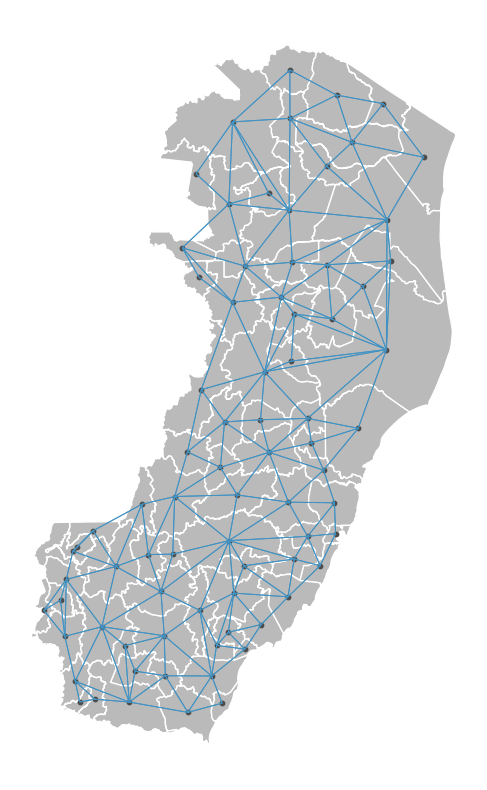

In [37]:
# Construindo spatial weights object
w = weights.contiguity.Queen.from_dataframe(censo_es)

# Plotando spatial weights
plot_spatial_weights(w, censo_es);

In [35]:
# Transformando weights em binario (Se 1 = is neighbor, 0 = not neighbor)
w.transform = "B"

# Showing neighbors indexes
w.neighbors

{0: [38, 7, 76, 77, 25, 26, 60, 61],
 1: [2, 3, 4, 46, 15],
 2: [16, 1, 3, 42, 43, 14, 15],
 3: [1, 2, 75, 4],
 4: [1, 75, 3, 46],
 5: [73, 74, 27, 44],
 6: [77, 52, 20, 8, 26, 45, 62],
 7: [0, 53, 72, 25, 60],
 8: [17, 20, 45, 6],
 9: [19, 50, 51, 22],
 10: [49, 11, 21],
 11: [10, 21],
 12: [56, 59, 13, 70],
 13: [68, 56, 57, 58, 59, 12],
 14: [16, 49, 2, 40, 42],
 15: [16, 1, 2, 17, 45, 46],
 16: [48, 17, 2, 18, 40, 14, 15],
 17: [16, 48, 19, 20, 8, 45, 15],
 18: [16, 49, 48, 40],
 19: [48, 17, 50, 20, 52, 22, 9],
 20: [17, 19, 52, 6, 8],
 21: [48, 49, 24, 10, 11],
 22: [48, 19, 23, 24, 9, 41],
 23: [24, 41, 22],
 24: [48, 21, 22, 23, 41],
 25: [0, 7, 72, 26, 27, 45],
 26: [0, 45, 6, 25, 77],
 27: [5, 72, 73, 44, 45, 25],
 28: [32, 34, 37],
 29: [37, 30, 55],
 30: [32, 67, 37, 55, 57, 58, 29, 31],
 31: [32, 33, 30, 57],
 32: [33, 34, 37, 28, 30, 31],
 33: [32, 34, 35, 36, 57, 31],
 34: [32, 33, 35, 28],
 35: [33, 34, 36],
 36: [33, 35, 57],
 37: [32, 54, 55, 28, 29, 30],
 38: [0, 76,

In [36]:
# Showing weights
w.weights

{0: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 1: [1.0, 1.0, 1.0, 1.0, 1.0],
 2: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 3: [1.0, 1.0, 1.0, 1.0],
 4: [1.0, 1.0, 1.0, 1.0],
 5: [1.0, 1.0, 1.0, 1.0],
 6: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 7: [1.0, 1.0, 1.0, 1.0, 1.0],
 8: [1.0, 1.0, 1.0, 1.0],
 9: [1.0, 1.0, 1.0, 1.0],
 10: [1.0, 1.0, 1.0],
 11: [1.0, 1.0],
 12: [1.0, 1.0, 1.0, 1.0],
 13: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 14: [1.0, 1.0, 1.0, 1.0, 1.0],
 15: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 16: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 17: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 18: [1.0, 1.0, 1.0, 1.0],
 19: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 20: [1.0, 1.0, 1.0, 1.0, 1.0],
 21: [1.0, 1.0, 1.0, 1.0, 1.0],
 22: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 23: [1.0, 1.0, 1.0],
 24: [1.0, 1.0, 1.0, 1.0, 1.0],
 25: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 26: [1.0, 1.0, 1.0, 1.0, 1.0],
 27: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 28: [1.0, 1.0, 1.0],
 29: [1.0, 1.0, 1.0],
 30: [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0],
 31

In [39]:
# Calculando Spatial Lag
censo_es['w_pop'] = weights.lag_spatial(w, censo_es['População'])
censo_es['w_PIB'] = weights.lag_spatial(w, censo_es['PIB2020'])

censo_es[['geocodigo', 'População', 'w_pop', 'PIB2020', 'w_PIB']].head()

,geocodigo,w_pop,w_pop,PIB2020,w_PIB
0,3204609.0,142630.0,142630.0,492.689220,3560.395230
1,3204401.0,107876.0,107876.0,205.780060,4871.891878
2,3202801.0,331238.0,331238.0,3244.132528,13925.450256
3,3204203.0,90955.0,90955.0,585.407919,4788.174362
4,3202603.0,78973.0,78973.0,305.544212,2194.142273


In [41]:
# Calculando Spatial Lag
censo_es.loc[w.neighbors[0], ['geocodigo', 'População', 'w_pop']]['População'].sum()


142630

In [42]:
# Variable of interest (populacao)
y_pop_count = censo_es['População']

# Calculando Moran I statistic
moran = Moran(y_pop_count, w)

# Moran's I statistic
moran.I


0.49347027870896837

In [43]:
moran.p_sim

0.001

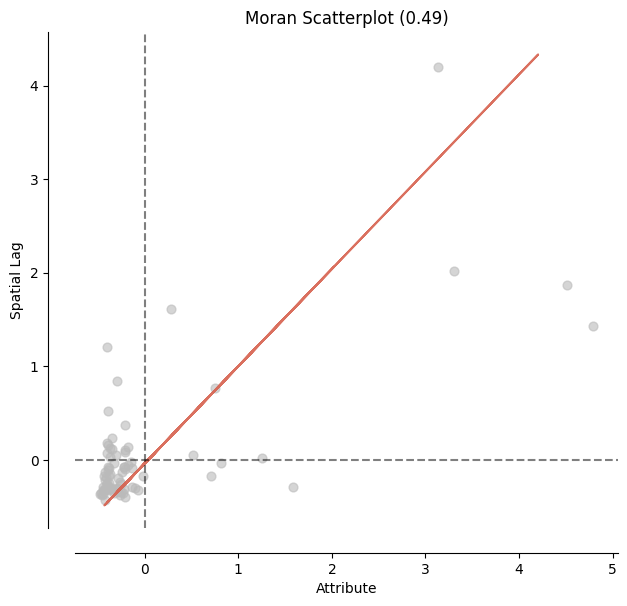

In [44]:
# Plotando Moran I scatter plot
moran_scatterplot(moran);

In [46]:
# Variable of interest (PIB2020)
y_total_monthly_income = censo_es['PIB2020']

# Calculating Moran's I statistic
moran = Moran(y_total_monthly_income, w)

# Moran's I statistic
moran.I




0.5034698667165052

In [47]:
moran.p_sim

0.001

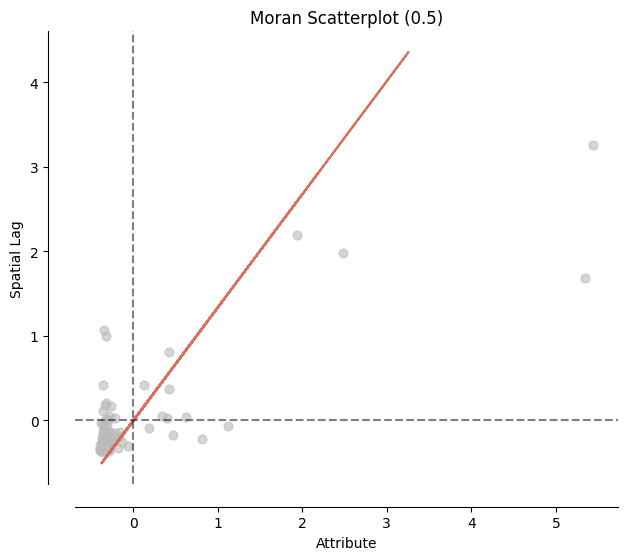

In [48]:
moran_scatterplot(moran);

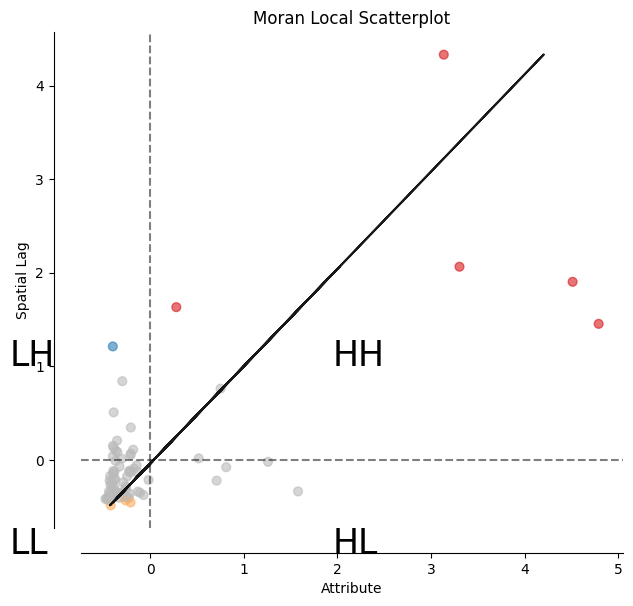

In [51]:
# Local Moran's I
pop_count_local_moran = Moran_Local(y_pop_count, w)

# Plotting Local Moran's I scatterplot of pop_count
fig, ax = moran_scatterplot(pop_count_local_moran, p=0.05);

plt.text(1.95, 1, 'HH', fontsize=25)
plt.text(1.95, -1.0, 'HL', fontsize=25)
plt.text(-1.5, 1, 'LH', fontsize=25)
plt.text(-1.5, -1, 'LL', fontsize=25)
plt.show()

In [54]:
# creating column with local_moran classification
censo_es['pop_count_local_moran'] = pop_count_local_moran.q

# Dict to map local moran's classification codes
local_moran_classification = {1: 'HH', 2: 'LH', 3: 'LL', 4: 'HL'}

# Mapping local moran's classification codes
censo_es['pop_count_local_moran'] = censo_es['pop_count_local_moran'].map(local_moran_classification)

# p-value for each observation/neighbor pair
censo_es['pop_count_local_moran_p_sim'] = pop_count_local_moran.p_sim

# If p-value > 0.05 it is not statistical significant
censo_es['pop_count_local_moran'] = np.where(censo_es['pop_count_local_moran_p_sim'] > 0.05, 'ns', censo_es['pop_count_local_moran'])

censo_es.head()

,geocodigo,Município,macroEstad,areaKm2,População,PIB2020,geometry,w_pop,w_PIB,pop_count_local_moran,pop_count_local_moran_p_sim
0,3204609.0,Santa Teresa,Metropolitana,683.108621,23853,492.689220,"POLYGON ((340944.863 7815924.731, 340905.372 7...",142630.0,3560.395230,ns,0.095
1,3204401.0,Rio Novo do Sul,Sul,204.502044,11630,205.780060,"POLYGON ((301064.597 7711443.436, 301068.852 7...",107876.0,4871.891878,ns,0.307
2,3202801.0,Itapemirim,Sul,562.074632,34957,3244.132528,"POLYGON ((317035.735 7691540.830, 317044.666 7...",331238.0,13925.450256,ns,0.388
3,3204203.0,Piúma,Sul,73.958692,22388,585.407919,"POLYGON ((322985.174 7695224.809, 322978.818 7...",90955.0,4788.174362,ns,0.400
4,3202603.0,Iconha,Sul,203.557384,14083,305.544212,"POLYGON ((304354.753 7712887.125, 304400.386 7...",78973.0,2194.142273,ns,0.308


In [55]:
# Plotting Local Moran's I classification map of pop_count column
censo_es.explore(
    tiles='cartodbpositron',
    column='pop_count_local_moran',
    height='70%',
    width='70%',
    cmap=[
    '#D7191C', # Red
    '#FDAE61', # Orange
    '#ABD9E9', # Light Blue
    '#2C7BB6', # Blue
    '#D3D3D3'  # Grey
    ],
    style_kwds={
        'stroke': True,
        'edgecolor': 'k',
        'linewidth': 0.03,
        'fillOpacity': 1
        
        },
    )

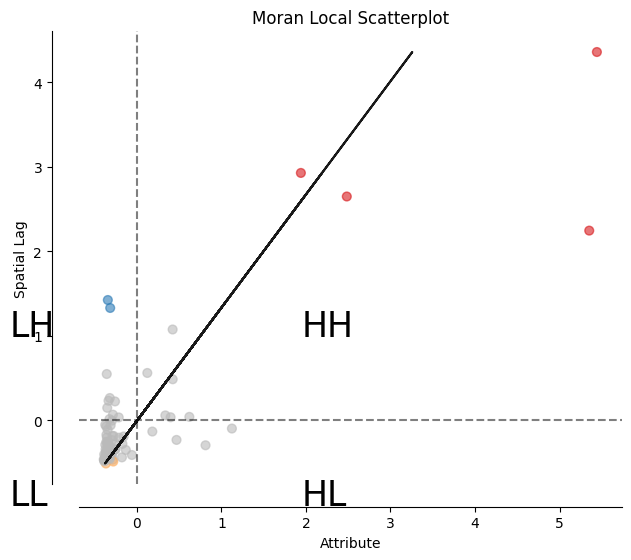

In [56]:
# Local Moran's I
total_monthly_income_local_moran = Moran_Local(y_total_monthly_income, w)

# Plotting Local Moran's I scatterplot of pop_count
fig, ax = moran_scatterplot(total_monthly_income_local_moran, p=0.05);

plt.text(1.95, 1, 'HH', fontsize=25)
plt.text(1.95, -1.0, 'HL', fontsize=25)
plt.text(-1.5, 1, 'LH', fontsize=25)
plt.text(-1.5, -1, 'LL', fontsize=25)
plt.show()

In [57]:
# creating column with local_moran classification
censo_es['total_monthly_income_local_moran'] = total_monthly_income_local_moran.q

# Dict to map local moran's classification codes
local_moran_classification = {1: 'HH', 2: 'LH', 3: 'LL', 4: 'HL'}

# Mapping local moran's classification codes
censo_es['total_monthly_income_local_moran'] = censo_es['total_monthly_income_local_moran'].map(local_moran_classification)

# p-value for each observation/neighbor pair
censo_es['total_monthly_income_local_moran_p_sim'] = total_monthly_income_local_moran.p_sim

# If p-value > 0.05 it is not statistical significant
censo_es['total_monthly_income_local_moran'] = np.where(censo_es['total_monthly_income_local_moran_p_sim'] > 0.05, 'ns', censo_es['total_monthly_income_local_moran'])

# Plotting Local Moran's I classification map of pop_count column
censo_es.explore(
    tiles='cartodbpositron',
    column='total_monthly_income_local_moran',
    height='70%',
    width='70%',
    cmap=[
    '#D7191C', # Red
    '#FDAE61', # Orange
    '#ABD9E9', # Light Blue
    '#2C7BB6', # Blue
    '#D3D3D3'  # Grey
    ],
    style_kwds={
        'stroke': True,
        'edgecolor': 'k',
        'linewidth': 0.03,
        'fillOpacity': 1
        
        },
    )